<font size="+15">**Appendix**</font>


# **Data Cleaning**
#### - This is to clean the database by dropping unnecessary columns and filtering 2018~2021

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [ ]:
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Assignment 1/Combined Listing Data [Summary].csv')

<ipython-input-4-f4e5fffdda14>:1: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Combined Listing Data [Summary].csv')


In [ ]:
## add Year and Month Columns
fulldf['Year'] = list(fulldf['Scrape File'].str.split('_').str.get(2))
fulldf['Year'] = pd.to_numeric(fulldf['Year'], errors='coerce')

fulldf['Month'] = list(fulldf['Scrape File'].str.split('_').str.get(3))
fulldf['Month'] = pd.to_numeric(fulldf['Month'], errors='coerce')

In [ ]:
# Add a Column with YYYY-MM format timeframe
fulldf['Year and Month'] = pd.to_datetime(fulldf['Year'].astype(str) + '-' + fulldf['Month'].astype(str), format='%Y-%m')

In [ ]:
fulldf = fulldf[fulldf['Year and Month'] >= '2018-01-01']

In [ ]:
## remove zero price listing
fulldf = fulldf[fulldf["price"] != 0]

In [ ]:
fulldf.shape

(1389007, 21)

In [ ]:
fulldf['room_type'].value_counts()

Entire home/apt    868605
Private room       460816
Shared room         55827
Hotel room           3759
Name: room_type, dtype: int64

In [ ]:
## Group data into two groups: Pre-covid (2018.12 - 2019.12) and covid (2020.1 - 2021.1)
year_2018 = fulldf[(fulldf["Year"] == 2018) & (fulldf["Month"] == 12)]
year_2019 = fulldf[fulldf["Year"] == 2019]

In [ ]:
pre_covid_years = pd.concat([year_2018, year_2019], ignore_index=True)

In [ ]:
covid_years = fulldf[fulldf["Year"].between(2020, 2021)]

## **Data Visualization**

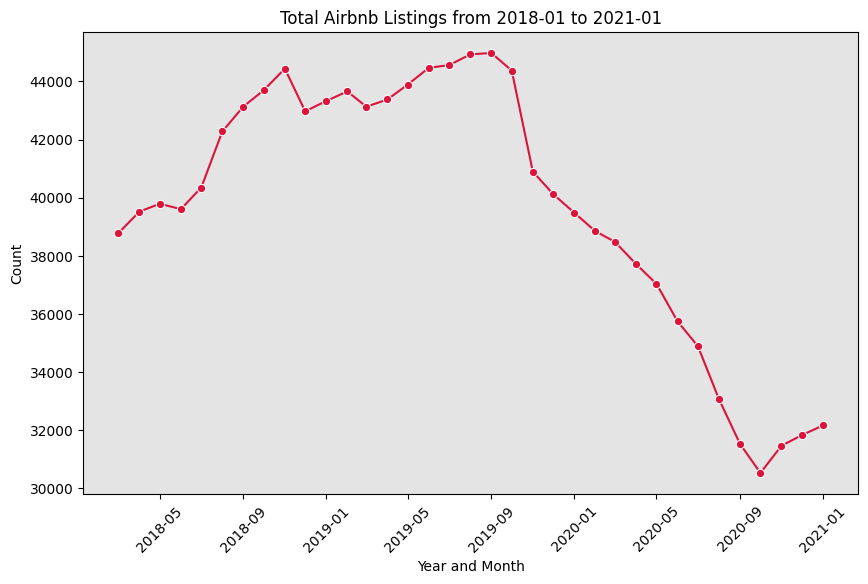

In [ ]:
plt.figure(figsize=(10, 6))

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Calculate the count of 'Entire home/apt' listings per year and month
count_all_type = fulldf.groupby('Year and Month').size()

# Reset index to make 'Year and Month' a regular column
count_all_type = count_all_type.reset_index(name='Count')

# Plot the scatter plot
sns.lineplot(data = count_all_type, x='Year and Month', y='Count', color='crimson', marker='o')

plt.title("Total Airbnb Listings from 2018-01 to 2021-01")
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

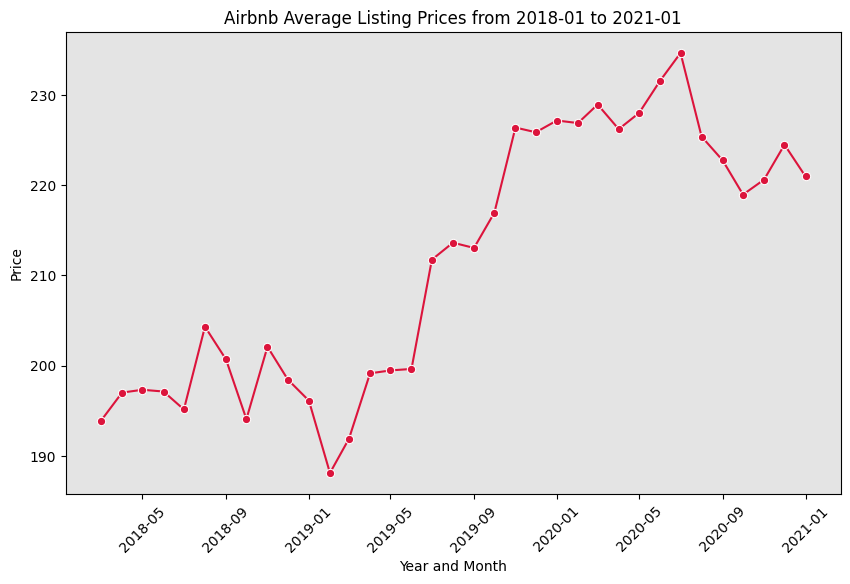

In [ ]:
plt.figure(figsize=(10, 6))

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Calculate the avg prices of listings per year and month
price_all_type = fulldf.groupby('Year and Month')['price'].mean()

# Reset index to make 'Year and Month' a regular column
price_all_type = price_all_type.reset_index(name='Price')

# Plot the scatter plot
sns.lineplot(data = price_all_type, x='Year and Month', y='Price', color = 'crimson', marker='o')

plt.title("Airbnb Average Listing Prices from 2018-01 to 2021-01")
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

In [ ]:
# Calculate the count of 'Entire home/apt' listings per year and month
count_entire_home = fulldf[fulldf['room_type']=='Entire home/apt'].groupby('Year and Month').size()
count_entire_home = count_entire_home.reset_index(name='Count')

# Repeat the same steps for other room types
count_private_room = fulldf[fulldf['room_type']=='Private room'].groupby('Year and Month').size()
count_private_room = count_private_room.reset_index(name='Count')

count_shared_room = fulldf[fulldf['room_type']=='Shared room'].groupby('Year and Month').size()
count_shared_room = count_shared_room.reset_index(name='Count')

count_hotel_room = fulldf[fulldf['room_type'] == 'Hotel room'].groupby('Year and Month').size()
count_hotel_room = count_hotel_room.reset_index(name='Count')

# Calculate the avg prices of 'Entire home/apt' listings per year and month
price_entire_home = fulldf[fulldf['room_type']=='Entire home/apt'].groupby('Year and Month')['price'].mean()
price_entire_home = price_entire_home.reset_index(name='Price')

# Repeat the same steps for other room types
price_private_room = fulldf[fulldf['room_type']=='Private room'].groupby('Year and Month')['price'].mean()
price_private_room = price_private_room.reset_index(name='Price')

price_shared_room = fulldf[fulldf['room_type']=='Shared room'].groupby('Year and Month')['price'].mean()
price_shared_room = price_shared_room.reset_index(name='Price')

price_hotel_room = fulldf[fulldf['room_type']=='Hotel room'].groupby('Year and Month')['price'].mean()
price_hotel_room = price_hotel_room.reset_index(name='Price')

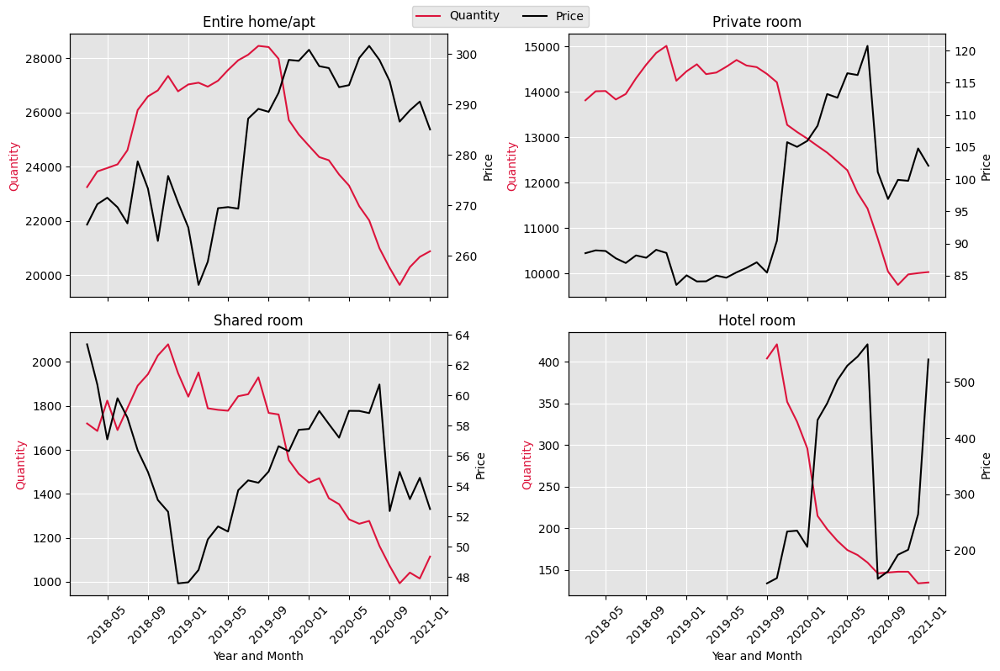

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 8), sharex=True)

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Plot Quantity
sns.lineplot(data=count_entire_home, x='Year and Month', y='Count', label='Quantity', ax=axes[0, 0], color='crimson', legend= False)
sns.lineplot(data=count_private_room, x='Year and Month', y='Count', label='Quantity', ax=axes[0, 1], color='crimson', legend= False)
sns.lineplot(data=count_shared_room, x='Year and Month', y='Count', label='Quantity', ax=axes[1, 0], color='crimson', legend= False)
sns.lineplot(data=count_hotel_room, x='Year and Month', y='Count', label='Quantity', ax=axes[1, 1], color='crimson', legend= False)

# Plot Price on a separate y-axis
ax_price_entire_home = axes[0, 0].twinx()
ax_price_private_room = axes[0, 1].twinx()
ax_price_shared_room = axes[1, 0].twinx()
ax_price_hotel_room = axes[1, 1].twinx()

# Plot Price
sns.lineplot(data=price_entire_home, x='Year and Month', y='Price', label='Price', ax=ax_price_entire_home, color='black', legend= False)
sns.lineplot(data=price_private_room, x='Year and Month', y='Price', label='Price', ax=ax_price_private_room, color='black', legend= False)
sns.lineplot(data=price_shared_room, x='Year and Month', y='Price', label='Price', ax=ax_price_shared_room, color='black', legend= False)
sns.lineplot(data=price_hotel_room, x='Year and Month', y='Price', label='Price', ax=ax_price_hotel_room, color='black', legend= False)

# Set titles for each subplot
axes[0, 0].set_title('Entire home/apt')
axes[0, 1].set_title('Private room')
axes[1, 0].set_title('Shared room')
axes[1, 1].set_title('Hotel room')

# # Set legends with appropriate labels
# axes[0, 0].legend(['Quantity'], loc='upper left')
# ax_price_entire_home.legend(['Price'], loc='upper left')


# Set y-axis label colors
axes[0, 0].set_ylabel('Quantity', color='crimson')
ax_price_entire_home.set_ylabel('Price', color='black')

axes[0, 1].set_ylabel('Quantity', color='crimson')
ax_price_private_room.set_ylabel('Price', color='black')

axes[1, 0].set_ylabel('Quantity', color='crimson')
ax_price_shared_room.set_ylabel('Price', color='black')

axes[1, 1].set_ylabel('Quantity', color='crimson')
ax_price_hotel_room.set_ylabel('Price', color='black')

# Rotate x-axis labels for better visibility
for ax in axes.flat:
    ax.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()

#Grid
axes[0, 0].grid(True, color='white')
axes[0, 1].grid(True, color='white')
axes[1, 0].grid(True, color='white')
axes[1, 1].grid(True, color='white')

handles1, labels1 = axes[0, 0].get_legend_handles_labels()
handles2, labels2 = ax_price_entire_home.get_legend_handles_labels()
fig.legend(handles1 + handles2, labels1 + labels2, loc='upper center', ncol=2)

# Display the plot
plt.show()

##**Data Visualization By Latitude and Longitude**

In [ ]:
# Keep the unique value for each ID(listing) and save it as a new dataset
pre_covid_years_unique = pre_covid_years.drop_duplicates(subset=['id'])
covid_years_unique = covid_years.drop_duplicates(subset=['id'])

In [ ]:
# Check the counties
county = pd.DataFrame(pre_covid_years_unique['neighbourhood'].unique()).sort_values(0)
county

,0
238,Acton
118,Adams-Normandie
117,Agoura Hills
81,Agua Dulce
113,Alhambra
...,...
182,Willowbrook
210,Wilmington
106,Windsor Square
122,Winnetka


### Pre covid year

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Create a base map centered at Los Angeles
map_center = [34.0522, -118.2437]
pre_covid_year_map = folium.Map(location=map_center, zoom_start=12)

# Create a MarkerCluster to add multiple markers efficiently
marker_cluster = MarkerCluster().add_to(pre_covid_year_map)

# Add markers for each latitude and longitude in your DataFrame
for index, row in pre_covid_years_unique.iterrows():
    folium.Marker([row['latitude'], row['longitude']]).add_to(marker_cluster)

# Save the map to an HTML file or display it
# my_map.save('my_map.html')
# or
pre_covid_year_map

###Post Covid year

In [ ]:
# Create a base map centered at Los Angeles
map_center = [34.0522, -118.2437]
covid_year_map = folium.Map(location=map_center, zoom_start=12)

# Create a MarkerCluster to add multiple markers efficiently
marker_cluster = MarkerCluster().add_to(covid_year_map)

# Add markers for each latitude and longitude in your DataFrame
for index, row in covid_years_unique.iterrows():
    folium.Marker([row['latitude'], row['longitude']]).add_to(marker_cluster)

# Save the map to an HTML file or display it
# my_map.save('my_map.html')
# or
covid_year_map

#### Build a table for changes in meidan price by geo - pre COVID versus During COVID

In [ ]:
from prettytable import PrettyTable

# Specify the Column Names while initializing the Table
myTable = PrettyTable(["Area / Period", "Median Price Before COVID", "Median Price During COVID", "Percentage delta"])

# Add rows
myTable.add_row(["Hollywood", "$125", "$128", "2.40 %"])
myTable.add_row(["Santa Monica", "$150", "$150", "0.00 %"])
myTable.add_row(["Hermosa_Beach", "$150", "$160", "6.67 %"])
myTable.add_row(["Long Beach", "$100", "$100", "0.00 %"])
myTable.add_row(["Los Angeles", "$115", "$130", "13.04 %"])
myTable.add_row(["Pasadena, Glendaale", "$110", "$125", "13.63 %"])
myTable.add_row(["San Fernando Valley", "$75", "$80", "6.67 %"])

print(myTable)

# Create a separate table for notes
notesTable = PrettyTable()
notesTable.field_names = ["Notes"]

# Add a row to the notes table
notesTable.add_row(["The reported average prices per area are calculated as the median   "])
notesTable.add_row(["values across three counties within each specified area."])

# Print the notes table
print(notesTable)

+---------------------+---------------------------+---------------------------+------------------+
|    Area / Period    | Median Price Before COVID | Median Price During COVID | Percentage delta |
+---------------------+---------------------------+---------------------------+------------------+
|      Hollywood      |            $125           |            $128           |      2.40 %      |
|     Santa Monica    |            $150           |            $150           |      0.00 %      |
|    Hermosa_Beach    |            $150           |            $160           |      6.67 %      |
|      Long Beach     |            $100           |            $100           |      0.00 %      |
|     Los Angeles     |            $115           |            $130           |     13.04 %      |
| Pasadena, Glendaale |            $110           |            $125           |     13.63 %      |
| San Fernando Valley |            $75            |            $80            |      6.67 %      |
+---------

In [ ]:
# For reference - The composition of each area
Hollywood = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Hollywood') | (pre_covid_years_unique['neighbourhood'] == 'Beverly Hills') | (pre_covid_years_unique['neighbourhood'] == 'West Hollywood')]['price'].median()
Santa_Monica = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Venice') | (pre_covid_years_unique['neighbourhood'] == 'Santa Monica') | (pre_covid_years_unique['neighbourhood'] == 'Sawtelle')]['price'].median()
Hermosa_Beach = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Hermosa Beach') | (pre_covid_years_unique['neighbourhood'] == 'Manhattan Beach') | (pre_covid_years_unique['neighbourhood'] == 'Redondo Beach')]['price'].median()
Long_Beach = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Long Beach') | (pre_covid_years_unique['neighbourhood'] == 'Signal Hill') ]['price'].median()
Los_Angeles = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Koreatown') | (pre_covid_years_unique['neighbourhood'] == 'Downtown') | (pre_covid_years_unique['neighbourhood'] == 'Westlake')]['price'].median()
Pasadena_Glendaale = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'Pasadena') | (pre_covid_years_unique['neighbourhood'] == 'South Pasadena') | (pre_covid_years_unique['neighbourhood'] == 'Glendale')]['price'].median()
San_Fernando_Valley = pre_covid_years_unique[(pre_covid_years_unique['neighbourhood'] == 'North Hills') | (pre_covid_years_unique['neighbourhood'] == 'San Fernando') | (pre_covid_years_unique['neighbourhood'] == 'Northridge')]['price'].median()

In [ ]:
print(Hollywood, Santa_Monica, Hermosa_Beach, Long_Beach, Los_Angeles, Pasadena_Glendaale, San_Fernando_Valley)

125.0 150.0 150.0 100.0 115.0 110.0 75.0


## **Reference**

In [ ]:
fulldf_testing = fulldf.copy()

In [ ]:
# fulldf_testing['listing_start_year'] = fulldf_testing['Year and Month'].dt.year
# listing_end_year = fulldf_testing.groupby('id')['listing_start_year'].max()
# fulldf_testing['listing_duration'] = fulldf_testing['Year and Month'].dt.year - fulldf_testing['id'].map(listing_end_year)

listing_start_year = fulldf_testing.groupby('id')['Year and Month'].min().dt.year
listing_end_year = fulldf_testing.groupby('id')['Year and Month'].max().dt.year
fulldf_testing['listing_duration'] = (listing_end_year - listing_start_year) +1

# Step 4: Group the data by year and calculate the average price change per year for each listing
fulldf_testing['price_change_per_year'] = fulldf_testing['price'] / fulldf_testing['listing_duration']

# Step 5: Aggregate the average price changes over all listings for each year
average_price_change_per_year = fulldf_testing.groupby('listing_start_year')['price_change_per_year'].mean()

# Step 6: Visualize the overall price changes over the years
plt.figure(figsize=(10, 6))
average_price_change_per_year.plot(kind='line', marker='o', color='b')
plt.title('Average Airbnb Price Change Per Year')
plt.xlabel('Year')
plt.ylabel('Average Price Change Per Year')
plt.grid(True)
plt.xticks(average_price_change_per_year.index)  # Set x ticks to be years
plt.tight_layout()
plt.show()

In [ ]:
fulldf[fulldf['room_type'] == 'Hotel room']

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,...,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,Scrape File,Year,Month,Year and Month
1010423,92,51922,Panoramic Ocean View Studio Loft,239712,Silvio,Other Cities,Santa Monica,34.01355,-118.49685,Hotel room,...,1,358,2019-09-03,3.30,10,319.0,los_angeles_2019_09_listings.csv,2019,9,2019-09-01
1010427,96,53125,Ocean View Studio Apt on Ocean Ave!,239712,Silvio,Other Cities,Santa Monica,34.01155,-118.49564,Hotel room,...,2,391,2019-08-16,3.58,10,310.0,los_angeles_2019_09_listings.csv,2019,9,2019-09-01
1010428,97,53579,Ocean View Studio/ 2 beds/ AMAZING!,239712,Silvio,Other Cities,Santa Monica,34.01357,-118.49539,Hotel room,...,2,141,2019-09-07,1.30,10,361.0,los_angeles_2019_09_listings.csv,2019,9,2019-09-01
1010476,145,93359,Ocean Views on Ocean Avenue!,239712,Silvio,Other Cities,Santa Monica,34.01360,-118.49553,Hotel room,...,1,179,2019-07-17,1.75,10,364.0,los_angeles_2019_09_listings.csv,2019,9,2019-09-01
1010484,153,100074,Budget Accommodation Beachside!,239712,Silvio,Other Cities,Santa Monica,34.01261,-118.49584,Hotel room,...,1,374,2019-08-31,3.67,10,324.0,los_angeles_2019_09_listings.csv,2019,9,2019-09-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1622686,21251,37939585,Modern Hotel Room in Downtown Los Angeles #8,9402067,Joseph,City of Los Angeles,Westlake,34.05116,-118.26383,Hotel room,...,1,53,2020-12-23,3.21,5,89.0,los_angeles_2021_01_listings.csv,2021,1,2021-01-01
1622722,21287,37997555,Motel rooms for rent,288181355,Rita,Other Cities,Lynwood,33.93063,-118.21246,Hotel room,...,1,43,2020-09-05,2.59,6,83.0,los_angeles_2021_01_listings.csv,2021,1,2021-01-01
1622977,21542,38368273,Office Short-term or Long-term Lease Bev Hills,263498930,Natasha,City of Los Angeles,Century City,34.05991,-118.41371,Hotel room,...,30,0,NaN,NaN,1,364.0,los_angeles_2021_01_listings.csv,2021,1,2021-01-01
1623073,21638,38494821,Motel Room 2,288181355,Rita,Other Cities,Lynwood,33.93251,-118.21253,Hotel room,...,1,66,2020-10-25,4.26,6,82.0,los_angeles_2021_01_listings.csv,2021,1,2021-01-01


In [ ]:
a = pre_covid_years['id'].nunique()
b = covid_years['id'].nunique()

In [ ]:
print(a,b)

74694 58722


In [ ]:
c = pre_covid_years['host_id'].nunique()
d = covid_years['host_id'].nunique()

In [ ]:
print(c,d)

38701 29308


In [ ]:
pre_covid_years['neighbourhood'].value_counts().iloc[:10]

Hollywood          34406
Venice             33553
Downtown           21539
Long Beach         20869
Santa Monica       14357
Hollywood Hills    13428
Westlake           12311
Koreatown          11067
Mid-Wilshire       11051
West Hollywood     10826
Name: neighbourhood, dtype: int64

In [ ]:
covid_years['neighbourhood'].value_counts().iloc[:10]

Venice             22821
Hollywood          22584
Long Beach         21797
Santa Monica       15788
Downtown           15690
Hollywood Hills    10292
West Hollywood      9006
Glendale            7523
Westlake            7209
Rowland Heights     7165
Name: neighbourhood, dtype: int64

In [ ]:
pre_covid_years.shape

(564671, 21)

In [ ]:
covid_years.shape

(452752, 21)

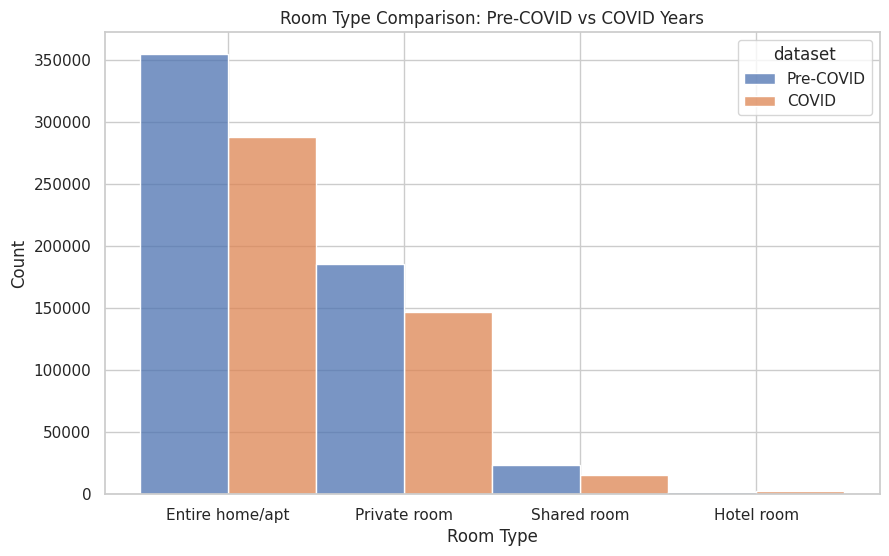

In [ ]:
plt.figure(figsize=(10, 6))

sns.set_theme(style="whitegrid")

# Combine both datasets
combined_data = pd.concat([pre_covid_years.assign(dataset='Pre-COVID'),
                           covid_years.assign(dataset='COVID')])

sns.histplot(data=combined_data, x='room_type', hue='dataset', multiple='dodge')

plt.title('Room Type Comparison: Pre-COVID vs COVID Years')
plt.xlabel('Room Type')
plt.ylabel('Count')

plt.show()

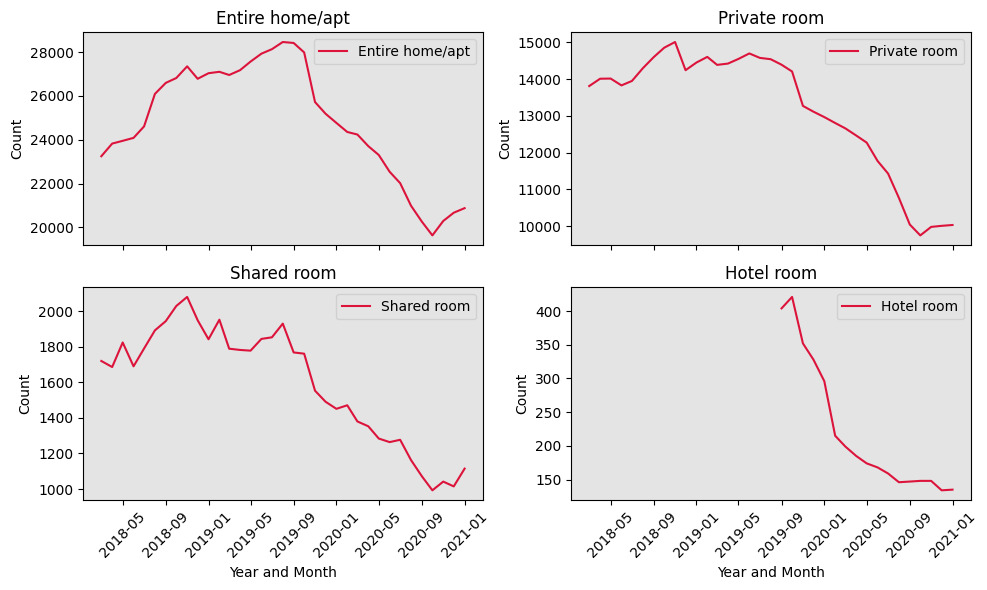

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 6),sharex= True)

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Calculate the count of 'Entire home/apt' listings per year and month

# Plot 'Entire home/apt' listings per year and month
sns.lineplot(data=count_entire_home, x='Year and Month', y='Count', label='Entire home/apt', ax=axes[0, 0], color= 'crimson')

# Plot 'Private room' listings per year and month
sns.lineplot(data=count_private_room, x='Year and Month', y='Count', label='Private room', ax=axes[0, 1], color= 'crimson')

# Plot 'Shared room' listings per year and month
sns.lineplot(data=count_shared_room, x='Year and Month', y='Count', label='Shared room', ax=axes[1, 0], color= 'crimson')

# Plot 'Hotel room' listings per year and month
sns.lineplot(data=count_hotel_room, x='Year and Month', y='Count', label='Hotel room', ax=axes[1, 1], color= 'crimson')

# Set titles for each subplot
axes[0, 0].set_title('Entire home/apt')
axes[0, 1].set_title('Private room')
axes[1, 0].set_title('Shared room')
axes[1, 1].set_title('Hotel room')

# Rotate x-axis labels for better visibility
for ax in axes.flat:
    ax.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()

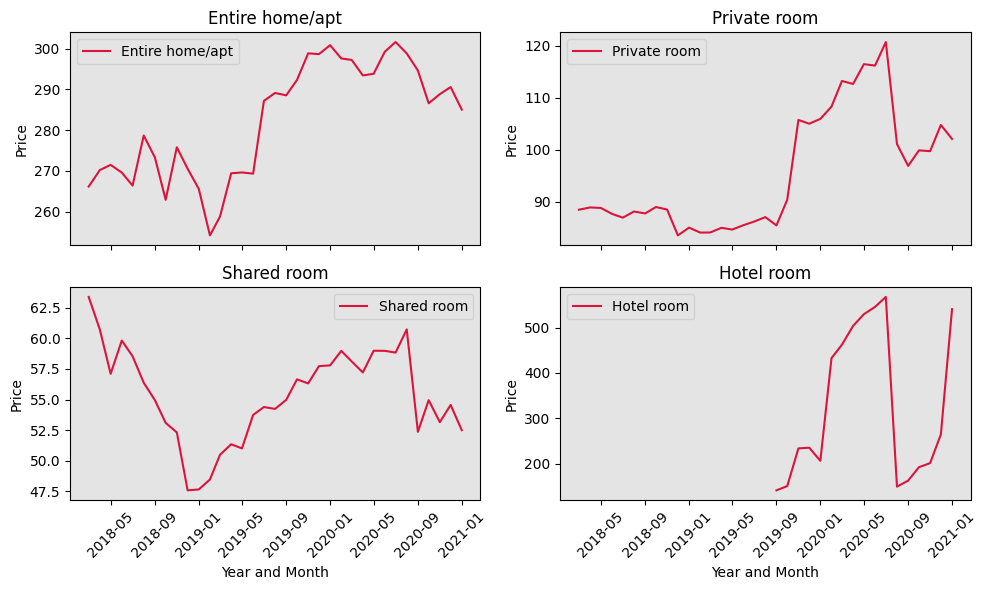

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10, 6), sharex= True)

sns.set_style(rc = {'axes.facecolor': '#e4e4e4'})

# Plot 'Entire home/apt' listings per year and month
sns.lineplot(data=price_entire_home, x='Year and Month', y='Price', label='Entire home/apt', ax=axes[0, 0], color= 'crimson')

# Plot 'Private room' listings per year and month
sns.lineplot(data=price_private_room, x='Year and Month', y='Price', label='Private room', ax=axes[0, 1], color= 'crimson')

# Plot 'Shared room' listings per year and month
sns.lineplot(data=price_shared_room, x='Year and Month', y='Price', label='Shared room', ax=axes[1, 0], color= 'crimson')

# Plot 'Hotel room' listings per year and month
sns.lineplot(data=price_hotel_room, x='Year and Month', y='Price', label='Hotel room', ax=axes[1, 1], color= 'crimson')

# Set titles for each subplot
axes[0, 0].set_title('Entire home/apt')
axes[0, 1].set_title('Private room')
axes[1, 0].set_title('Shared room')
axes[1, 1].set_title('Hotel room')

# Rotate x-axis labels for better visibility
for ax in axes.flat:
    ax.tick_params(axis='x', rotation=45)

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()

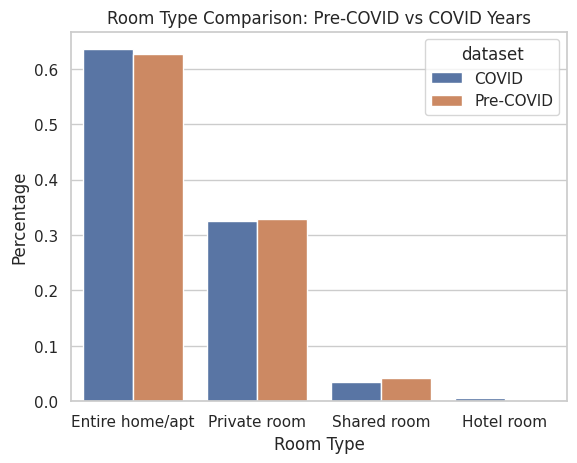

In [ ]:
#Room type in percentage
covid_years_normalized = covid_years[['room_type']].value_counts(normalize= True)
covid_years_normalized = covid_years_normalized.to_frame().reset_index()

pre_covid_years_normalized = pre_covid_years[['room_type']].value_counts(normalize= True)
pre_covid_years_normalized = pre_covid_years_normalized.to_frame().reset_index()

room_type_normalized = pd.concat([covid_years_normalized.assign(dataset='COVID'), pre_covid_years_normalized.assign(dataset='Pre-COVID')])
room_type_normalized = room_type_normalized.rename(columns= {0: 'percentage'})

sns.barplot(data=room_type_normalized, x='room_type', y='percentage', hue='dataset')
sns.set_theme(style="whitegrid")

plt.title('Room Type Comparison: Pre-COVID vs COVID Years')
plt.xlabel('Room Type')
plt.ylabel('Percentage')

plt.show()

In [ ]:
room_type_normalized

,room_type,percentage,dataset
0,Entire home/apt,0.635328,COVID
1,Private room,0.324619,COVID
2,Shared room,0.035074,COVID
3,Hotel room,0.004978,COVID
0,Entire home/apt,0.627636,Pre-COVID
1,Private room,0.328450,Pre-COVID
2,Shared room,0.041249,Pre-COVID
3,Hotel room,0.002665,Pre-COVID


In [ ]:
mean_price = combined_data.groupby(['dataset', 'room_type']).agg(mean=('price','mean'))

In [ ]:
mean_price.sort_values(by='dataset',ascending=False,inplace=True)

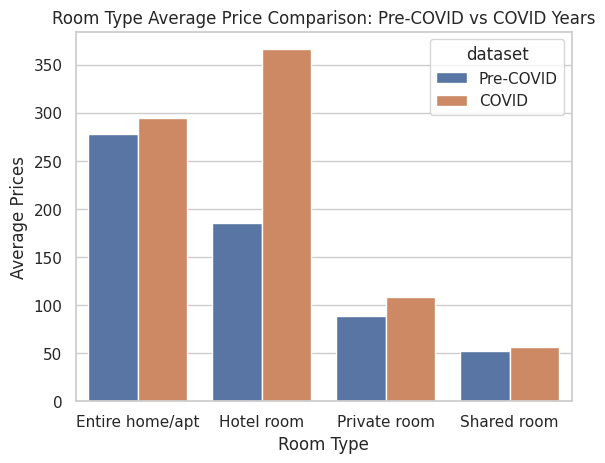

In [ ]:
sns.barplot(data=mean_price, x='room_type', y='mean', hue='dataset')
sns.set_theme(style="whitegrid")
plt.title('Room Type Average Price Comparison: Pre-COVID vs COVID Years')
plt.xlabel('Room Type')
plt.ylabel('Average Prices')

plt.show()

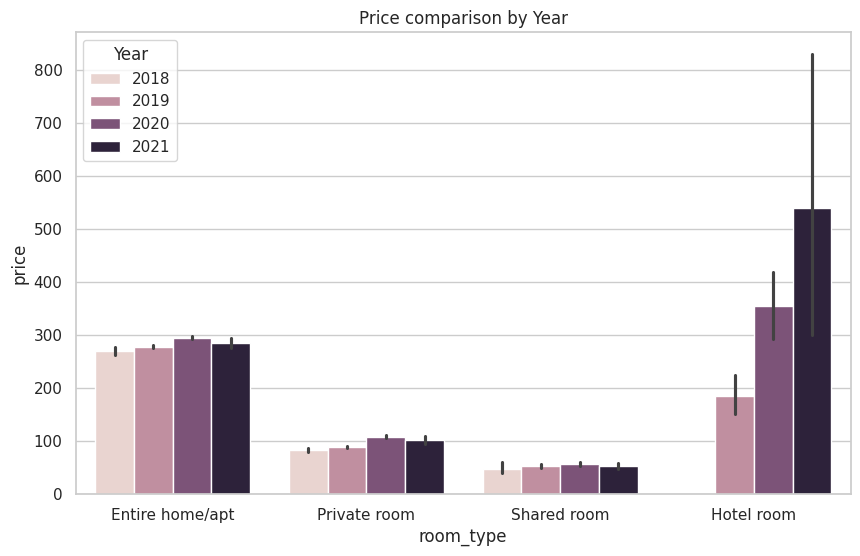

In [ ]:
plt.figure(figsize = (10,6))
sns.set_theme(style="whitegrid")
sns.barplot(data=combined_data, x='room_type', y = 'price', hue='Year')
plt.title('Price comparison by Year')
plt.show()

In [ ]:
fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Combined Listing Data [Summary].csv')

<ipython-input-36-f4e5fffdda14>:1: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  fulldf = pd.read_csv('/content/drive/MyDrive/DSO 574/Combined Listing Data [Summary].csv')


In [ ]:
fulldf['Year'] = list(fulldf['Scrape File'].str.split('_').str.get(2))
fulldf['Year'] = pd.to_numeric(fulldf['Year'], errors='coerce')

In [ ]:
fulldf = fulldf[fulldf["Year"].between(2018, 2021)]

In [ ]:
fulldf.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,Scrape File,Year
244104,0,109,Amazing bright elegant condo park front *UPGRA...,521,Paolo,NaN,Culver City,33.982095,-118.384935,Entire home/apt,122,7,2,2016-05-15,0.03,1,344.0,los_angeles_2018_03_listings.csv,2018
244105,1,344,Family perfect;Pool;Near Studios!,767,Melissa,NaN,Burbank,34.165616,-118.334582,Entire home/apt,168,1,1,2016-12-30,0.05,1,0.0,los_angeles_2018_03_listings.csv,2018
244106,2,2404,deleted,2633,Jjjj,NaN,Del Rey,33.984640,-118.440064,Shared room,85,1,0,NaN,NaN,1,365.0,los_angeles_2018_03_listings.csv,2018
244107,3,2732,Zen Life at the Beach,3041,Yoga Priestess,NaN,Santa Monica,34.004750,-118.481266,Private room,155,1,17,2017-06-14,0.21,2,313.0,los_angeles_2018_03_listings.csv,2018
244108,4,2864,*Upscale Professional Home with Beautiful Studio*,3207,Bernadine,NaN,Bellflower,33.876189,-118.113968,Entire home/apt,80,2,0,NaN,NaN,2,0.0,los_angeles_2018_03_listings.csv,2018


In [ ]:
## we are missing 11 months of data
fulldf[fulldf['Year']==2021]['Scrape File']

1601435    los_angeles_2021_01_listings.csv
1601436    los_angeles_2021_01_listings.csv
1601437    los_angeles_2021_01_listings.csv
1601438    los_angeles_2021_01_listings.csv
1601439    los_angeles_2021_01_listings.csv
                         ...               
1633605    los_angeles_2021_01_listings.csv
1633606    los_angeles_2021_01_listings.csv
1633607    los_angeles_2021_01_listings.csv
1633608    los_angeles_2021_01_listings.csv
1633609    los_angeles_2021_01_listings.csv
Name: Scrape File, Length: 32175, dtype: object

In [ ]:
## let's focus only on Entire Home/apt since they are the main business
working_data = fulldf.loc[ (fulldf['room_type'] == 'Entire home/apt')]

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
latitude_data = working_data[['latitude', 'longitude']]

clusters = KMeans(n_clusters=5).fit(latitude_data)

working_data['Geographical Cluster'] = clusters.predict(latitude_data)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-39-450bcd300d8c>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_data['Geographical Cluster'] = clusters.predict(latitude_data)


<Axes: xlabel='latitude', ylabel='longitude'>

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


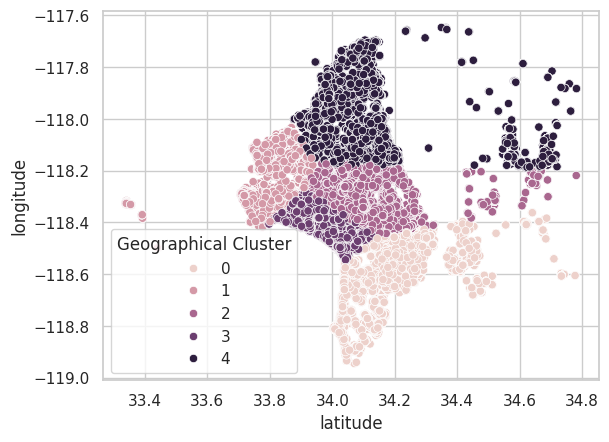

In [ ]:
sns.scatterplot(data = working_data,
                x = 'latitude',
                y = 'longitude',
                hue = 'Geographical Cluster')

In [ ]:
## Change columns into numerical
numerical_list = ['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']
for i in numerical_list:
  fulldf[i] = pd.to_numeric(fulldf[i], errors='coerce')

In [ ]:
pre_covid_years['price'].describe()

count    564671.000000
mean        206.035709
std         548.800804
min           4.000000
25%          70.000000
50%         109.000000
75%         184.000000
max       25000.000000
Name: price, dtype: float64

In [ ]:
covid_years['price'].describe()

count    452752.000000
mean        226.136605
std         648.105173
min          10.000000
25%          70.000000
50%         110.000000
75%         189.000000
max       25000.000000
Name: price, dtype: float64

In [ ]:
# Use 1st, 2nd & 3rd quartile of pre_covid_years prices: 70, 109, 184 as threshold
# Create new column price group
combined_data['price_group'] = 0

# Group 1: 0 <= p < 70, Group 2: 70 <= p < 109, Group 3: 109 <= p < 184, Group 4: 184 <= p
combined_data.loc[combined_data['price'] < 70, 'price_group'] = 1
combined_data.loc[(combined_data['price'] >= 70) & (combined_data['price'] < 109), 'price_group'] = 2
combined_data.loc[(combined_data['price'] >= 109) & (combined_data['price'] < 184), 'price_group'] = 3
combined_data.loc[combined_data['price'] >= 184, 'price_group'] = 4

In [ ]:
# Normalized in percentage
total_counts = combined_data.groupby('dataset')['price'].count()
price_groups = combined_data.groupby(['dataset', 'price_group']).size()
normalized_price_groups = (price_groups / total_counts * 100).reset_index(name='percentage')
normalized_price_groups.sort_values(by = 'dataset', ascending= False, inplace= True)

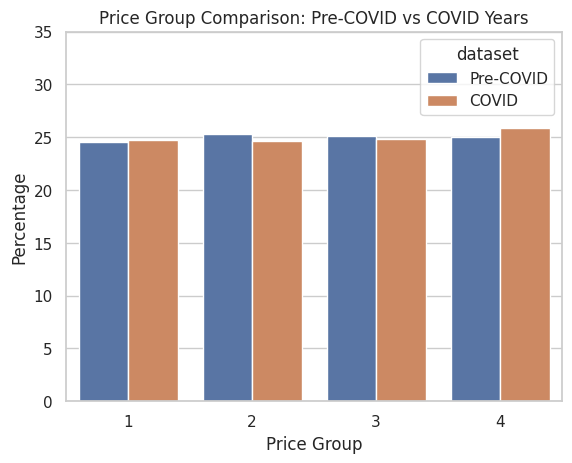

In [ ]:
# Plotting

sns.barplot(data=normalized_price_groups, x='price_group', y='percentage', hue='dataset')
sns.set_theme(style="whitegrid")

plt.title('Price Group Comparison: Pre-COVID vs COVID Years')
plt.xlabel('Price Group')
plt.ylabel('Percentage')
plt.ylim(0,35)

plt.show()

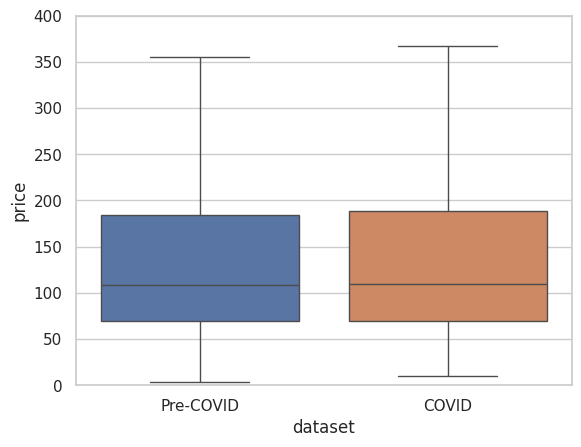

In [ ]:
sns.boxplot(data=combined_data, x="dataset", y="price", hue= 'dataset', showfliers = False)
plt.ylim(0,400)
plt.show()

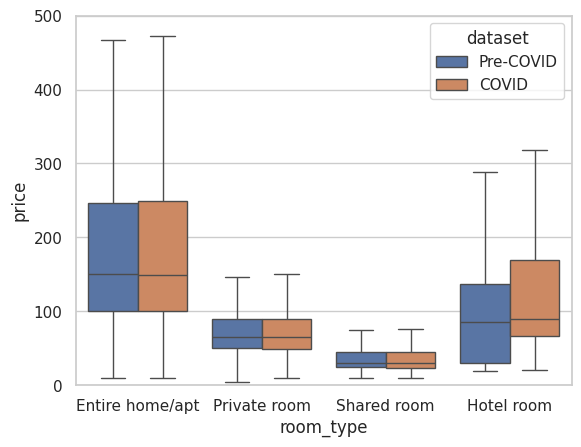

In [ ]:
sns.boxplot(data=combined_data, x="room_type", y="price", hue= 'dataset', showfliers=False)
plt.ylim(0,500)
plt.show()